In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import os
import random
import shutil
import torch

In [ ]:
path_to_files = '/content/drive/MyDrive/Thesis/FSD50K'
os.chdir(path_to_files)

In [ ]:
#Rroot directory of the audio files
train_root_dir = '/content/drive/MyDrive/Thesis/FSD50K/FSD50K.dev_audio/'
test_root_dir = '/content/drive/MyDrive/Thesis/FSD50K/FSD50K.eval_audio/'

train_audio_files = [os.path.join(train_root_dir, f) for f in os.listdir(train_root_dir) if f.endswith('.wav')]
print(f'Found {len(train_audio_files)} training audio files.')

#Putting the test audio files in a list (from the evaluation set)
test_audio_files = [os.path.join(test_root_dir, f) for f in os.listdir(test_root_dir) if f.endswith('.wav')]
print(f'Found {len(test_audio_files)} test audio files.')

'''
# Create lists to store the file paths
train_audio_files = []
test_audio_files = []

# List all training audio files
for root, _, files in os.walk(train_root_dir):
    for file in files:
        if file.endswith('.wav'):
            train_audio_files.append(os.path.join(root, file))

print(f'Found {len(train_audio_files)} training audio files.')

# List all test audio files (from the evaluation set)
for root, _, files in os.walk(test_root_dir):
    for file in files:
        if file.endswith('.wav'):
            test_audio_files.append(os.path.join(root, file))

print(f'Found {len(test_audio_files)} test audio files.')
'''

Found 40966 training audio files.
Found 10231 test audio files.


"\n# Create lists to store the file paths\ntrain_audio_files = []\ntest_audio_files = []\n\n# List all training audio files\nfor root, _, files in os.walk(train_root_dir):\n    for file in files:\n        if file.endswith('.wav'):\n            train_audio_files.append(os.path.join(root, file))\n\nprint(f'Found {len(train_audio_files)} training audio files.')\n\n# List all test audio files (from the evaluation set)\nfor root, _, files in os.walk(test_root_dir):\n    for file in files:\n        if file.endswith('.wav'):\n            test_audio_files.append(os.path.join(root, file))\n\nprint(f'Found {len(test_audio_files)} test audio files.')\n"

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f'Using device: {device}')

Using device: cuda


## Supervised

In [ ]:
import pandas as pd
import numpy as np
from sklearn.utils.class_weight import compute_class_weight

#Load the CSV files
train_csv_path = '/content/drive/MyDrive/Thesis/FSD50K/FSD50K.metadata/collection/collection_dev.csv'
test_csv_path = '/content/drive/MyDrive/Thesis/FSD50K/FSD50K.metadata/collection/collection_eval.csv'

#Load the metadata
train_metadata = pd.read_csv(train_csv_path)
test_metadata = pd.read_csv(test_csv_path)

#Ensuring no NaN values in the labels column by replacing them with an empty string
train_metadata['labels'].fillna('', inplace=True)
test_metadata['labels'].fillna('', inplace=True)

#Create a label-to-index mapping
unique_labels = pd.Series([label for labels in train_metadata['labels'].str.split(',') for label in labels if label]).unique()
label_to_idx = {label: idx for idx, label in enumerate(unique_labels)}

unique_labels = set()
for labels in train_metadata['labels']:
    #Clean up labels by stripping spaces and avoiding empty strings
    label_list = [label.strip() for label in labels.split(',') if label.strip()]
    unique_labels.update(label_list)

#Convert the set back to a sorted list to create consistent indexing
unique_labels = sorted(unique_labels)

#Output the cleaned set of labels for debugging
print(unique_labels)

#Update label_to_idx mapping
label_to_idx = {label: idx for idx, label in enumerate(unique_labels)}

num_classes = len(unique_labels)
print(f"Number of unique classes: {num_classes}")

#Number of unique labels
num_labels = len(unique_labels)

#Create a mapping from filename to label index for training
train_filename_to_label = {}
for _, row in train_metadata.iterrows():
    if row['labels']:
        labels = row['labels'].split(',')  # Split multiple labels
        label_vector = np.zeros(num_labels, dtype=int)
        for label in labels:
            if label in label_to_idx:
                label_vector[label_to_idx[label]] = 1
        train_filename_to_label[f"{row['fname']}.wav"] = label_vector

#Flatten all labels into a single list for weight computation
all_labels = []
for labels in train_metadata['labels']:
    label_list = [label.strip() for label in labels.split(',') if label.strip()]
    all_labels.extend(label_list)

#Compute class weights
class_weights = compute_class_weight(class_weight='balanced', classes=np.unique(all_labels), y=all_labels)
class_weights = torch.tensor(class_weights, dtype=torch.float).to(device)

#Do the same for the test set
test_filename_to_label = {}
for _, row in test_metadata.iterrows():
    if row['labels']:
        labels = row['labels'].split(',')
        label_vector = np.zeros(num_labels, dtype=int)
        for label in labels:
            if label in label_to_idx:
                label_vector[label_to_idx[label]] = 1
        test_filename_to_label[f"{row['fname']}.wav"] = label_vector

#Print some keys to check
print(list(train_filename_to_label.keys())[:10])
print(label_to_idx)
print(num_labels)
print(f"Number of unique classes: {num_classes}")

['Accelerating_and_revving_and_vroom', 'Accordion', 'Acoustic_guitar', 'Air_conditioning', 'Air_horn_and_truck_horn', 'Aircraft', 'Aircraft_engine', 'Alarm', 'Alarm_clock', 'Alto_saxophone', 'Ambulance_(siren)', 'Animal', 'Applause', 'Arrow', 'Artillery_fire', 'Babbling', 'Baby_cry_and_infant_cry', 'Baby_laughter', 'Bark', 'Bass_drum', 'Bass_guitar', 'Bassoon', 'Bathtub_(filling_or_washing)', 'Battle_cry', 'Bee_and_wasp_and_etc.', 'Bell', 'Bicycle', 'Bicycle_bell', 'Bird', 'Bird_flight_and_flapping_wings', 'Bird_vocalization_and_bird_call_and_bird_song', 'Bleat', 'Blender', 'Boat_and_Water_vehicle', 'Boiling', 'Boom', 'Bowed_string_instrument', 'Brass_instrument', 'Breathing', 'Burping_and_eructation', 'Burst_and_pop', 'Bus', 'Busy_signal', 'Buzz', 'Buzzer', 'Camera', 'Cap_gun', 'Car', 'Car_alarm', 'Car_passing_by', 'Cash_register', 'Cat', 'Cattle_and_bovinae', 'Caw', 'Cello', 'Cellphone_buzz_and_vibrating_alert', 'Chainsaw', 'Chant', 'Chatter', 'Cheering', 'Chewing_and_mastication', '

labels
Laughter               743
Snare_drum             693
Cello                  643
Clarinet               591
Saxophone              582
                      ... 
Snicker                  1
Whoop                    1
Arrow                    1
Civil_defense_siren      1
Quack                    1
Name: count, Length: 355, dtype: int64


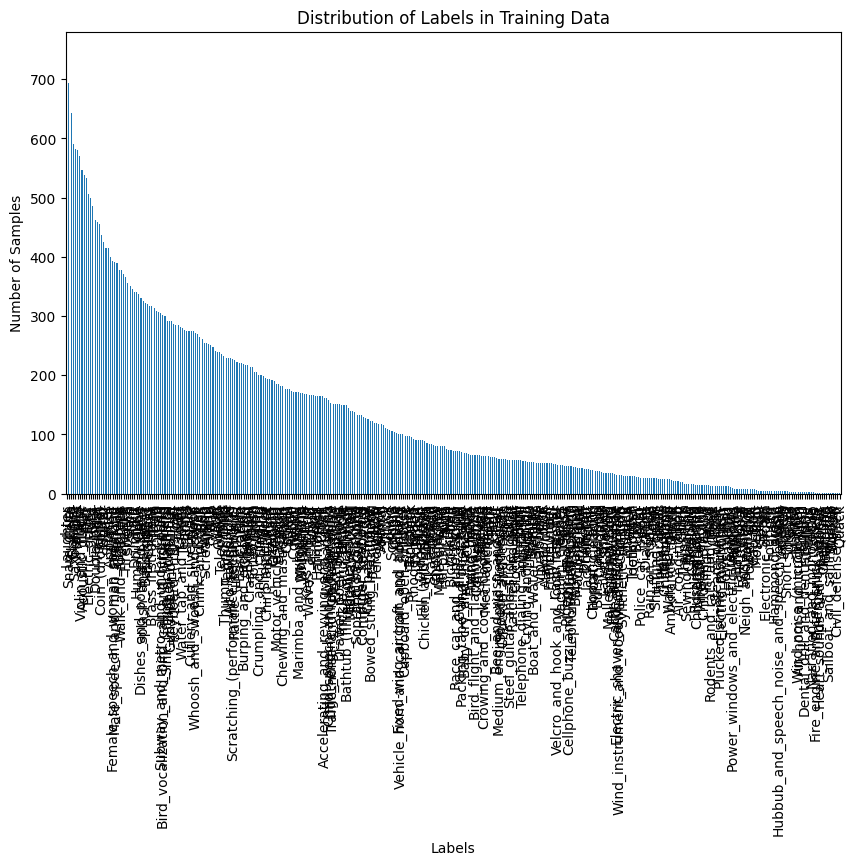

In [ ]:
#Split the labels by comma and explode them into separate rows
all_labels = train_metadata['labels'].str.split(',').explode()

#Count the occurrences of each label
label_counts = all_labels.value_counts()

#Print out the counts for each label
print(label_counts)

#Plot the distribution of labels
plt.figure(figsize=(10, 6))
label_counts.plot(kind='bar')
plt.title('Distribution of Labels in Training Data')
plt.xlabel('Labels')
plt.ylabel('Number of Samples')
plt.show()

In [ ]:
import librosa
import numpy as np
from sklearn.preprocessing import StandardScaler

#Initialize the scaler
scaler = StandardScaler()

#Collect a sample of mel-spectrograms from the training set to fit the scaler
mel_samples = []
sample_size = 2500  # Adjust this if needed based on memory resources

#Determine the maximum length of the mel-spectrograms
max_len = 0

for i, file_path in enumerate(train_audio_files):
    if i >= sample_size:
        break
    y, sr = librosa.load(file_path, sr=22050)
    mel_spectrogram = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128, fmax=8000)
    mel_spectrogram_db = librosa.power_to_db(mel_spectrogram, ref=np.max)

    #Update max_len if current mel-spectrogram is longer
    if mel_spectrogram_db.shape[1] > max_len:
        max_len = mel_spectrogram_db.shape[1]

#Pad the mel-spectrograms to the maximum length and fit the scaler
for i, file_path in enumerate(train_audio_files):
    if i >= sample_size:
        break
    y, sr = librosa.load(file_path, sr=22050)
    mel_spectrogram = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128, fmax=8000)
    mel_spectrogram_db = librosa.power_to_db(mel_spectrogram, ref=np.max)

    #Pad the spectrogram to the maximum length
    pad_width = max_len - mel_spectrogram_db.shape[1]
    if pad_width > 0:
        mel_spectrogram_db = np.pad(mel_spectrogram_db, ((0, 0), (0, pad_width)), mode='constant')

    mel_samples.append(mel_spectrogram_db.flatten())

#Stack all samples to fit the scaler
mel_samples = np.vstack(mel_samples)
scaler.fit(mel_samples)

print(f"Number of unique classes: {num_classes}")

Number of unique classes: 354


In [ ]:
def preprocess_audio(file_path, scaler):
    y, sr = librosa.load(file_path, sr=22050)
    mel_spectrogram = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128, fmax=8000)
    mel_spectrogram_db = librosa.power_to_db(mel_spectrogram, ref=np.max)

    #Pad the mel-spectrogram to the maximum length
    if mel_spectrogram_db.shape[1] < max_len:
        pad_width = max_len - mel_spectrogram_db.shape[1]
        mel_spectrogram_db = np.pad(mel_spectrogram_db, ((0, 0), (0, pad_width)), mode='constant')

    #Normalize the mel-spectrogram
    original_shape = mel_spectrogram_db.shape
    mel_spectrogram_db = scaler.transform(mel_spectrogram_db.flatten().reshape(1, -1)).reshape(original_shape)

    return mel_spectrogram_db

In [ ]:
import torch
from torch.utils.data import Dataset, DataLoader

class FSD50KDataset(Dataset):
    def __init__(self, file_paths, filename_to_label, scaler, transform=None):
        self.file_paths = file_paths
        self.filename_to_label = filename_to_label
        self.scaler = scaler
        self.transform = transform

    def __len__(self):
        return len(self.file_paths)

    def __getitem__(self, idx):
        file_path = self.file_paths[idx]
        mel_spectrogram = preprocess_audio(file_path, self.scaler)
        basename = os.path.basename(file_path).strip()

        if basename not in self.filename_to_label:
            print(f"Warning: {basename} not found in filename_to_label")
            return None, None

        label = self.filename_to_label[basename]

        #Debugging prints to check label shape and content
        #print(f"Processing file: {basename}")
        #print(f"Mel Spectrogram shape: {mel_spectrogram.shape}")
        #print(f"Label shape: {label.shape}")  # Expect shape to be (355,)
        #print(f"Label values: {label}")  # Ensure it's a one-hot encoded vector

        if self.transform:
            mel_spectrogram = self.transform(mel_spectrogram)

        return mel_spectrogram, label

In [ ]:
def collate_fn(batch):
    batch = [b for b in batch if b[0] is not None]
    if len(batch) == 0:
        return None, None
    inputs, labels = zip(*batch)
    inputs = torch.nn.utils.rnn.pad_sequence([torch.tensor(i) for i in inputs], batch_first=True)
    labels = torch.tensor(labels)
    return inputs, labels

In [ ]:
from torch.utils.data import WeightedRandomSampler
import numpy as np

train_dataset = FSD50KDataset(file_paths=train_audio_files, filename_to_label=train_filename_to_label, scaler=scaler)

print(f"Number of unique classes: {num_classes}")

#Normalize the paths
train_audio_files = [os.path.normpath(file) for file in train_audio_files]

#Calculate the class weights
all_labels = np.concatenate([
    train_filename_to_label[os.path.normpath(filename)]
    for filename in train_audio_files
])

class_sample_count = np.array([len(np.where(all_labels == t)[0]) for t in np.unique(all_labels)])
weight = 1. / class_sample_count
samples_weight = np.array([weight[t] for t in all_labels])

all_labels = np.concatenate([train_filename_to_label[filename] for filename in train_audio_files])

#Calculate the class weights
class_sample_count = np.array([len(np.where(all_labels == t)[0]) for t in np.unique(all_labels)])
weight = 1. / class_sample_count
samples_weight = np.array([weight[t] for t in all_labels])

#Create a sampler
sampler = WeightedRandomSampler(samples_weight, len(samples_weight))

#Now create the DataLoader using the sampler
train_dataloader = DataLoader(train_dataset, batch_size=8, sampler=sampler, collate_fn=collate_fn)

print(f"Number of unique classes: {num_classes}")

test_dataset = FSD50KDataset(file_paths=test_audio_files, filename_to_label=test_filename_to_label, scaler=scaler)
test_dataloader = DataLoader(test_dataset, batch_size=8, shuffle=False, collate_fn=collate_fn)

print(f"Number of unique classes: {num_classes}")
print(f"Length of train dataset: {len(train_dataset)}")
print(f"Length of test dataset: {len(test_dataset)}")

#Checking the first batch
for batch in train_dataloader:
    if batch[0] is None:
        print("Encountered an empty batch.")
    else:
        print(batch)
    break

Number of unique classes: 354


KeyError: '/content/drive/MyDrive/Thesis/FSD50K/FSD50K.dev_audio/391174.wav'

In [ ]:
#Checking the shapes of inputs and labels
for inputs, labels in train_dataloader:
    print(inputs.shape)
    print(labels.shape)
    break

torch.Size([8, 128, 1935])
torch.Size([8, 354])


In [ ]:
import torch.nn as nn
import torch.optim as optim

In [ ]:
unique_labels = set()
for labels in train_metadata['labels']:
    label_list = [label.strip() for label in labels.split(',') if label.strip()]
    unique_labels.update(label_list)
    #print(f"Unique labels after processing: {unique_labels}")

num_classes = len(unique_labels)
print(f"Final number of unique classes: {num_classes}")

Final number of unique classes: 354


In [ ]:
import torch
import torch.nn as nn

In [ ]:
class FocalLoss(nn.Module):
    def __init__(self, alpha=1, gamma=2):
        super(FocalLoss, self).__init__()
        self.alpha = alpha
        self.gamma = gamma

    def forward(self, inputs, targets):
        BCE_loss = nn.BCEWithLogitsLoss()(inputs, targets)
        pt = torch.exp(-BCE_loss)
        F_loss = self.alpha * (1 - pt) ** self.gamma * BCE_loss
        return F_loss

In [ ]:


class ImprovedAudioCNN(nn.Module):
    def __init__(self, num_classes):
        super(ImprovedAudioCNN, self).__init__()
        self.conv1 = nn.Conv2d(1, 32, kernel_size=3, stride=1, padding=1)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1)
        self.conv3 = nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1)
        self.conv4 = nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1)
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2, padding=0)
        self.batch_norm1 = nn.BatchNorm2d(32)
        self.batch_norm2 = nn.BatchNorm2d(64)
        self.batch_norm3 = nn.BatchNorm2d(128)
        self.batch_norm4 = nn.BatchNorm2d(256)
        self.dropout = nn.Dropout(p=0.5)

        #Initialize the linear layer with the correct size
        self._to_linear = 256 * 8 * 120
        self.fc1 = nn.Linear(self._to_linear, 512)
        self.fc2 = nn.Linear(512, num_classes)

    def conv_layers(self, x):
        x = self.pool(nn.ReLU()(self.batch_norm1(self.conv1(x))))
        x = self.pool(nn.ReLU()(self.batch_norm2(self.conv2(x))))
        x = self.pool(nn.ReLU()(self.batch_norm3(self.conv3(x))))
        x = self.pool(nn.ReLU()(self.batch_norm4(self.conv4(x))))
        return x

    def forward(self, x):
        x = self.conv_layers(x)
        x = x.view(-1, self._to_linear)  #Flatten
        x = nn.ReLU()(self.fc1(x))
        x = self.dropout(x)
        x = self.fc2(x)
        return x  # Return raw logits

#Model initialization and loss function
model = ImprovedAudioCNN(num_classes=354).to(device)
criterion = FocalLoss()
optimizer = optim.Adam(model.parameters(), lr=0.00001)

In [ ]:
#Training loop
num_epochs = 30

for epoch in range(num_epochs):
    model.train()
    for batch in train_dataloader:
        inputs, labels = batch
        inputs = inputs.unsqueeze(1).to(device)
        labels = labels.to(device).float()
        optimizer.zero_grad()
        outputs = model(inputs)


        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}')

        break

Epoch [1/30], Loss: 0.1875
Epoch [2/30], Loss: 0.1485
Epoch [3/30], Loss: 0.1320
Epoch [4/30], Loss: 0.1277
Epoch [5/30], Loss: 0.1145
Epoch [6/30], Loss: 0.1096
Epoch [7/30], Loss: 0.1092
Epoch [8/30], Loss: 0.1172
Epoch [9/30], Loss: 0.1026
Epoch [10/30], Loss: 0.1009
Epoch [11/30], Loss: 0.1042
Epoch [12/30], Loss: 0.1017
Epoch [13/30], Loss: 0.1082
Epoch [14/30], Loss: 0.1038
Epoch [15/30], Loss: 0.1003
Epoch [16/30], Loss: 0.1136
Epoch [17/30], Loss: 0.0985
Epoch [18/30], Loss: 0.1053
Epoch [19/30], Loss: 0.0926
Epoch [20/30], Loss: 0.0975
Epoch [21/30], Loss: 0.0941
Epoch [22/30], Loss: 0.0957
Epoch [23/30], Loss: 0.0927
Epoch [24/30], Loss: 0.0961
Epoch [25/30], Loss: 0.0933
Epoch [26/30], Loss: 0.0904
Epoch [27/30], Loss: 0.0876
Epoch [28/30], Loss: 0.0844
Epoch [29/30], Loss: 0.0890
Epoch [30/30], Loss: 0.0823


In [ ]:
import torchaudio.transforms as T

class AugmentedESC50Dataset(ESC50Dataset):
    def __init__(self, file_paths, filename_to_idx, scaler, transform=None):
        super(AugmentedESC50Dataset, self).__init__(file_paths, filename_to_idx, scaler, transform)
        self.augment = T.Compose([
            T.TimeStretch(),
            T.FrequencyMasking(freq_mask_param=30),
            T.TimeMasking(time_mask_param=30)
        ])

    def __getitem__(self, idx):
        mel_spectrogram, label = super().__getitem__(idx)
        if mel_spectrogram is not None and self.transform:
            mel_spectrogram = self.augment(mel_spectrogram)
        return mel_spectrogram, label

In [ ]:
!pip install optuna

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 380.1/380.1 kB 14.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.0/233.0 kB 11.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.6/78.6 kB 6.3 MB/s eta 0:00:00


In [ ]:
train_dataset = ESC50Dataset(file_paths=train_audio_files, filename_to_idx=filename_to_idx, scaler=scaler)
val_dataset = ESC50Dataset(file_paths=test_audio_files, filename_to_idx=filename_to_idx, scaler=scaler)
train_dataloader = DataLoader(train_dataset, batch_size=8, shuffle=True, collate_fn=collate_fn)
val_dataloader = DataLoader(val_dataset, batch_size=8, shuffle=False, collate_fn=collate_fn)

In [ ]:
import optuna

def objective(trial):
    #Hyperparameters
    lr = trial.suggest_loguniform('lr', 1e-5, 1e-1)
    batch_size = trial.suggest_categorical('batch_size', [8, 16, 32, 64])

    # Model Defined
    model = ImprovedAudioCNN().to(device)  #Move model to device
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(model.parameters(), lr=lr)

    #Create DataLoader with suggested batch size
    train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, collate_fn=collate_fn)

    #Training loop
    num_epochs = 10
    for epoch in range(num_epochs):
        model.train()
        for batch in train_dataloader:
            inputs, labels = batch
            inputs = inputs.unsqueeze(1).to(device)
            labels = labels.to(device)  # Move labels to device

            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

    #Evaluate model on validation set
    model.eval()
    correct = 0
    total = 0
    with torch.no_grad():
        for inputs, labels in val_dataloader:
            inputs = inputs.unsqueeze(1).to(device)
            labels = labels.to(device)
            outputs = model(inputs)
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

    val_accuracy = 100 * correct / total
    return val_accuracy

In [ ]:
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=25)

print('Best trial:', study.best_trial.params)

[I 2024-08-11 16:22:21,237] A new study created in memory with name: no-name-4f9ac83a-b104-4cf7-a106-60d343aa44b8
<ipython-input-23-583557174cf6>:5: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  lr = trial.suggest_loguniform('lr', 1e-5, 1e-1)


File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx


[I 2024-08-11 16:31:31,280] Trial 0 finished with value: 54.60526315789474 and parameters: {'lr': 1.0199539477571434e-05, 'batch_size': 8}. Best is trial 0 with value: 54.60526315789474.
<ipython-input-23-583557174cf6>:5: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  lr = trial.suggest_loguniform('lr', 1e-5, 1e-1)


File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx


[I 2024-08-11 16:37:07,184] Trial 1 finished with value: 55.921052631578945 and parameters: {'lr': 2.069271275116499e-05, 'batch_size': 8}. Best is trial 1 with value: 55.921052631578945.
<ipython-input-23-583557174cf6>:5: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  lr = trial.suggest_loguniform('lr', 1e-5, 1e-1)


File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx


[I 2024-08-11 16:42:36,593] Trial 2 finished with value: 2.3026315789473686 and parameters: {'lr': 0.004587740047928418, 'batch_size': 32}. Best is trial 1 with value: 55.921052631578945.
<ipython-input-23-583557174cf6>:5: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  lr = trial.suggest_loguniform('lr', 1e-5, 1e-1)


File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx


[I 2024-08-11 16:47:56,766] Trial 3 finished with value: 57.89473684210526 and parameters: {'lr': 3.124578333973929e-05, 'batch_size': 32}. Best is trial 3 with value: 57.89473684210526.
<ipython-input-23-583557174cf6>:5: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  lr = trial.suggest_loguniform('lr', 1e-5, 1e-1)


File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx


[I 2024-08-11 16:53:12,599] Trial 4 finished with value: 4.276315789473684 and parameters: {'lr': 0.048145582852384725, 'batch_size': 64}. Best is trial 3 with value: 57.89473684210526.
<ipython-input-23-583557174cf6>:5: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  lr = trial.suggest_loguniform('lr', 1e-5, 1e-1)


File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx


[I 2024-08-11 16:58:34,054] Trial 5 finished with value: 58.88157894736842 and parameters: {'lr': 0.00013329244320953827, 'batch_size': 32}. Best is trial 5 with value: 58.88157894736842.
<ipython-input-23-583557174cf6>:5: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  lr = trial.suggest_loguniform('lr', 1e-5, 1e-1)


File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx


[I 2024-08-11 17:03:54,242] Trial 6 finished with value: 15.131578947368421 and parameters: {'lr': 0.0028464506612602535, 'batch_size': 64}. Best is trial 5 with value: 58.88157894736842.
<ipython-input-23-583557174cf6>:5: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  lr = trial.suggest_loguniform('lr', 1e-5, 1e-1)


File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx


[I 2024-08-11 17:09:11,715] Trial 7 finished with value: 0.9868421052631579 and parameters: {'lr': 0.009805072998255901, 'batch_size': 32}. Best is trial 5 with value: 58.88157894736842.
<ipython-input-23-583557174cf6>:5: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  lr = trial.suggest_loguniform('lr', 1e-5, 1e-1)


File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx


[I 2024-08-11 17:14:28,501] Trial 8 finished with value: 0.9868421052631579 and parameters: {'lr': 0.005909262160700427, 'batch_size': 64}. Best is trial 5 with value: 58.88157894736842.
<ipython-input-23-583557174cf6>:5: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  lr = trial.suggest_loguniform('lr', 1e-5, 1e-1)


File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx


[I 2024-08-11 17:19:56,004] Trial 9 finished with value: 1.3157894736842106 and parameters: {'lr': 0.03570930966208301, 'batch_size': 32}. Best is trial 5 with value: 58.88157894736842.
<ipython-input-23-583557174cf6>:5: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  lr = trial.suggest_loguniform('lr', 1e-5, 1e-1)


File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx


[I 2024-08-11 17:25:23,882] Trial 10 finished with value: 52.63157894736842 and parameters: {'lr': 0.00022098319661644424, 'batch_size': 16}. Best is trial 5 with value: 58.88157894736842.
<ipython-input-23-583557174cf6>:5: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  lr = trial.suggest_loguniform('lr', 1e-5, 1e-1)


File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx


[I 2024-08-11 17:30:45,532] Trial 11 finished with value: 59.21052631578947 and parameters: {'lr': 0.00017348426686766388, 'batch_size': 32}. Best is trial 11 with value: 59.21052631578947.
<ipython-input-23-583557174cf6>:5: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  lr = trial.suggest_loguniform('lr', 1e-5, 1e-1)


File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx


[I 2024-08-11 17:36:04,651] Trial 12 finished with value: 57.56578947368421 and parameters: {'lr': 0.0002266135463626212, 'batch_size': 32}. Best is trial 11 with value: 59.21052631578947.
<ipython-input-23-583557174cf6>:5: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  lr = trial.suggest_loguniform('lr', 1e-5, 1e-1)


File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx


[I 2024-08-11 17:41:27,279] Trial 13 finished with value: 50.6578947368421 and parameters: {'lr': 0.0002381940638444562, 'batch_size': 16}. Best is trial 11 with value: 59.21052631578947.
<ipython-input-23-583557174cf6>:5: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  lr = trial.suggest_loguniform('lr', 1e-5, 1e-1)


File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx


[I 2024-08-11 17:46:53,482] Trial 14 finished with value: 60.85526315789474 and parameters: {'lr': 8.334199230801675e-05, 'batch_size': 32}. Best is trial 14 with value: 60.85526315789474.
<ipython-input-23-583557174cf6>:5: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  lr = trial.suggest_loguniform('lr', 1e-5, 1e-1)


File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx


[I 2024-08-11 17:52:13,220] Trial 15 finished with value: 34.53947368421053 and parameters: {'lr': 0.0008394657171268426, 'batch_size': 32}. Best is trial 14 with value: 60.85526315789474.
<ipython-input-23-583557174cf6>:5: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  lr = trial.suggest_loguniform('lr', 1e-5, 1e-1)


File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx


[I 2024-08-11 17:57:31,918] Trial 16 finished with value: 60.526315789473685 and parameters: {'lr': 6.558498766021116e-05, 'batch_size': 32}. Best is trial 14 with value: 60.85526315789474.
<ipython-input-23-583557174cf6>:5: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  lr = trial.suggest_loguniform('lr', 1e-5, 1e-1)


File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx


[I 2024-08-11 18:02:51,625] Trial 17 finished with value: 60.19736842105263 and parameters: {'lr': 5.9202965973977355e-05, 'batch_size': 16}. Best is trial 14 with value: 60.85526315789474.
<ipython-input-23-583557174cf6>:5: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  lr = trial.suggest_loguniform('lr', 1e-5, 1e-1)


File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx


[I 2024-08-11 18:08:16,260] Trial 18 finished with value: 12.828947368421053 and parameters: {'lr': 0.000812096917499619, 'batch_size': 8}. Best is trial 14 with value: 60.85526315789474.
<ipython-input-23-583557174cf6>:5: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  lr = trial.suggest_loguniform('lr', 1e-5, 1e-1)


File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx


[I 2024-08-11 18:13:44,225] Trial 19 finished with value: 58.55263157894737 and parameters: {'lr': 4.8893559432554e-05, 'batch_size': 32}. Best is trial 14 with value: 60.85526315789474.
<ipython-input-23-583557174cf6>:5: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  lr = trial.suggest_loguniform('lr', 1e-5, 1e-1)


File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx


[I 2024-08-11 18:19:15,386] Trial 20 finished with value: 61.8421052631579 and parameters: {'lr': 7.76596479650577e-05, 'batch_size': 32}. Best is trial 20 with value: 61.8421052631579.
<ipython-input-23-583557174cf6>:5: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  lr = trial.suggest_loguniform('lr', 1e-5, 1e-1)


File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx


[I 2024-08-11 18:24:48,163] Trial 21 finished with value: 60.19736842105263 and parameters: {'lr': 8.103479155800432e-05, 'batch_size': 32}. Best is trial 20 with value: 61.8421052631579.
<ipython-input-23-583557174cf6>:5: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  lr = trial.suggest_loguniform('lr', 1e-5, 1e-1)


File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx


[I 2024-08-11 18:30:04,977] Trial 22 finished with value: 46.71052631578947 and parameters: {'lr': 0.00047407290128862557, 'batch_size': 32}. Best is trial 20 with value: 61.8421052631579.
<ipython-input-23-583557174cf6>:5: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  lr = trial.suggest_loguniform('lr', 1e-5, 1e-1)


File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx


[I 2024-08-11 18:35:41,204] Trial 23 finished with value: 48.026315789473685 and parameters: {'lr': 1.001643633247957e-05, 'batch_size': 32}. Best is trial 20 with value: 61.8421052631579.
<ipython-input-23-583557174cf6>:5: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  lr = trial.suggest_loguniform('lr', 1e-5, 1e-1)


File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx
File 5-234855-A-25 (1).wav not found in filename_to_idx


[I 2024-08-11 18:41:19,166] Trial 24 finished with value: 57.89473684210526 and parameters: {'lr': 2.856180248187029e-05, 'batch_size': 32}. Best is trial 20 with value: 61.8421052631579.


Best trial: {'lr': 7.76596479650577e-05, 'batch_size': 32}


In [ ]:
model = ImprovedAudioCNN().to(device)
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=7.76596479650577e-05)

num_epochs = 10

In [ ]:
from torch.optim.lr_scheduler import StepLR

scheduler = StepLR(optimizer, step_size=5, gamma=0.1)

for epoch in range(num_epochs):
    for batch in train_dataloader:
        inputs, labels = batch
        inputs = inputs.unsqueeze(1).to(device)
        labels = labels.to(device)
        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
    scheduler.step()  #Adjust learning rate
    print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}')

File 5-234855-A-25 (1).wav not found in filename_to_idx
Epoch [1/10], Loss: 3.9276
File 5-234855-A-25 (1).wav not found in filename_to_idx
Epoch [2/10], Loss: 3.4554
File 5-234855-A-25 (1).wav not found in filename_to_idx
Epoch [3/10], Loss: 2.3799
File 5-234855-A-25 (1).wav not found in filename_to_idx
Epoch [4/10], Loss: 3.2563
File 5-234855-A-25 (1).wav not found in filename_to_idx
Epoch [5/10], Loss: 0.7559
File 5-234855-A-25 (1).wav not found in filename_to_idx
Epoch [6/10], Loss: 1.5910
File 5-234855-A-25 (1).wav not found in filename_to_idx
Epoch [7/10], Loss: 1.4719
File 5-234855-A-25 (1).wav not found in filename_to_idx
Epoch [8/10], Loss: 2.8030
File 5-234855-A-25 (1).wav not found in filename_to_idx
Epoch [9/10], Loss: 2.9570
File 5-234855-A-25 (1).wav not found in filename_to_idx
Epoch [10/10], Loss: 1.6042


In [ ]:
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.metrics import multilabel_confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.metrics import classification_report

model.eval()
all_labels = []
all_predictions = []
best_f1 = 0
best_threshold = 0.5

with torch.no_grad():
    for inputs, labels in test_dataloader:
        inputs = inputs.unsqueeze(1).to(device)
        labels = labels.to(device).float()

        outputs = model(inputs)

        #Experiment with different thresholds
        for threshold in np.linspace(0.1, 0.9, 9):
            temp_predictions = (torch.sigmoid(outputs) > threshold).float()
            f1 = f1_score(labels.cpu().numpy(), temp_predictions.cpu().numpy(), average='micro')
            print(f'Threshold: {threshold}, F1-Score: {f1}')
            if f1 > best_f1:
                best_f1 = f1
                best_threshold = threshold

        print(f'Best Threshold: {best_threshold}, Best F1-Score: {best_f1}')

        #Apply best threshold
        predictions = (torch.sigmoid(outputs) > best_threshold).float()
        all_labels.extend(labels.cpu().numpy())
        all_predictions.extend(predictions.cpu().numpy())

#Convert to numpy arrays for evaluation
all_labels = np.array(all_labels)
all_predictions = np.array(all_predictions)

#Print classification report
print(classification_report(all_labels, all_predictions, zero_division=1))

'''
model.eval()  # Set the model to evaluation mode
correct = 0
total = 0

# Initialize lists to store true and predicted labels
all_labels = []
all_predictions = []

with torch.no_grad():  # No need to calculate gradients for evaluation
    for inputs, labels in test_dataloader:
        inputs = inputs.unsqueeze(1).to(device)  # Move inputs to GPU and add channel dimension
        labels = labels.to(device).float()  # Move labels to GPU

        outputs = model(inputs)

        # Apply threshold for multi-label classification
        predictions = (outputs > 0.5).float()

        total += labels.size(0) * labels.size(1)
        correct += (predictions == labels).sum().item()

        # Store labels and predictions
        all_labels.extend(labels.cpu().numpy())
        all_predictions.extend(predictions.cpu().numpy())

# Calculate accuracy (for multi-label, this is not traditional accuracy)
test_accuracy = 100 * correct / total

# Calculate precision, recall, and F1 score
precision = precision_score(all_labels, all_predictions, average='weighted')
recall = recall_score(all_labels, all_predictions, average='weighted')
f1 = f1_score(all_labels, all_predictions, average='weighted')

# Print results
print(f'Test Accuracy: {test_accuracy:.2f}%')
print(f'Precision: {precision:.2f}')
print(f'Recall: {recall:.2f}')
print(f'F1 Score: {f1:.2f}')
'''

Streaming output truncated to the last 5000 lines.
Threshold: 0.30000000000000004, F1-Score: 0.0056364490371066224
Threshold: 0.4, F1-Score: 0.0035523978685612786
Threshold: 0.5, F1-Score: 0.0
Threshold: 0.6, F1-Score: 0.0
Threshold: 0.7000000000000001, F1-Score: 0.0
Threshold: 0.8, F1-Score: 0.0
Threshold: 0.9, F1-Score: 0.0
Best Threshold: 0.8, Best F1-Score: 0.15384615384615385
Threshold: 0.1, F1-Score: 0.01053740779768177
Threshold: 0.2, F1-Score: 0.010252654705236178
Threshold: 0.30000000000000004, F1-Score: 0.010208816705336429
Threshold: 0.4, F1-Score: 0.010407632263660017
Threshold: 0.5, F1-Score: 0.022284122562674095
Threshold: 0.6, F1-Score: 0.0
Threshold: 0.7000000000000001, F1-Score: 0.0
Threshold: 0.8, F1-Score: 0.0
Threshold: 0.9, F1-Score: 0.0
Best Threshold: 0.8, Best F1-Score: 0.15384615384615385
Threshold: 0.1, F1-Score: 0.007037297677691767
Threshold: 0.2, F1-Score: 0.005932517612161662
Threshold: 0.30000000000000004, F1-Score: 0.004752851711026616
Threshold: 0.4, F1

"\nmodel.eval()  # Set the model to evaluation mode\ncorrect = 0\ntotal = 0\n\n# Initialize lists to store true and predicted labels\nall_labels = []\nall_predictions = []\n\nwith torch.no_grad():  # No need to calculate gradients for evaluation\n    for inputs, labels in test_dataloader:\n        inputs = inputs.unsqueeze(1).to(device)  # Move inputs to GPU and add channel dimension\n        labels = labels.to(device).float()  # Move labels to GPU\n\n        outputs = model(inputs)\n\n        # Apply threshold for multi-label classification\n        predictions = (outputs > 0.5).float()\n\n        total += labels.size(0) * labels.size(1)\n        correct += (predictions == labels).sum().item()\n\n        # Store labels and predictions\n        all_labels.extend(labels.cpu().numpy())\n        all_predictions.extend(predictions.cpu().numpy())\n\n# Calculate accuracy (for multi-label, this is not traditional accuracy)\ntest_accuracy = 100 * correct / total\n\n# Calculate precision, recal

## Unsupervised

In [ ]:
import torch.nn as nn

class AudioAutoencoder(nn.Module):
    def __init__(self):
        super(AudioAutoencoder, self).__init__()
        #Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(1, 16, kernel_size=3, stride=2, padding=1),
            nn.ReLU(),
            nn.Conv2d(16, 32, kernel_size=3, stride=2, padding=1),
            nn.ReLU(),
            nn.Conv2d(32, 64, kernel_size=7)
        )
        #Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(64, 32, kernel_size=7),
            nn.ReLU(),
            nn.ConvTranspose2d(32, 16, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(16, 1, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.Sigmoid()  #Sigmoid activation function
        )

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x

In [ ]:
model = AudioAutoencoder().to(device)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)

num_epochs = 20

for epoch in range(num_epochs):
    for inputs, _ in train_dataloader:
        inputs = inputs.unsqueeze(1).to(device)

        #Forward pass
        outputs = model(inputs)
        loss = criterion(outputs, inputs)  #Compare output to input

        #Backward and optimize
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}')

File 5-234855-A-25 (1).wav not found in filename_to_idx
Epoch [1/20], Loss: 0.7462
File 5-234855-A-25 (1).wav not found in filename_to_idx
Epoch [2/20], Loss: 0.7983
File 5-234855-A-25 (1).wav not found in filename_to_idx
Epoch [3/20], Loss: 1.0785
File 5-234855-A-25 (1).wav not found in filename_to_idx
Epoch [4/20], Loss: 0.2904
File 5-234855-A-25 (1).wav not found in filename_to_idx
Epoch [5/20], Loss: 1.4688
File 5-234855-A-25 (1).wav not found in filename_to_idx
Epoch [6/20], Loss: 0.6786
File 5-234855-A-25 (1).wav not found in filename_to_idx
Epoch [7/20], Loss: 0.8074
File 5-234855-A-25 (1).wav not found in filename_to_idx
Epoch [8/20], Loss: 0.6328
File 5-234855-A-25 (1).wav not found in filename_to_idx
Epoch [9/20], Loss: 0.2436
File 5-234855-A-25 (1).wav not found in filename_to_idx
Epoch [10/20], Loss: 2.8272
File 5-234855-A-25 (1).wav not found in filename_to_idx
Epoch [11/20], Loss: 1.0862
File 5-234855-A-25 (1).wav not found in filename_to_idx
Epoch [12/20], Loss: 0.9174
F

In [ ]:
from sklearn.cluster import KMeans

#Initialize an empty list to store the features
features = []

#Switch the model to evaluation mode
model.eval()

#Loop over your dataset and pass the data through the encoder
with torch.no_grad():
    for inputs, _ in test_dataloader:  #Ignore labels by using _
        inputs = inputs.unsqueeze(1).to(device)
        latent_features = model.encoder(inputs)

        #Flatten the feature maps
        latent_features = latent_features.view(latent_features.size(0), -1)  #Flatten all dimensions except batch

        features.append(latent_features.cpu().numpy())  #Move to CPU and convert to numpy array


In [ ]:
features = np.vstack(features)

#KMeans
kmeans = KMeans(n_clusters=20, random_state=0).fit(features)
cluster_labels = kmeans.labels_

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


In [ ]:
import numpy as np
from collections import Counter

#Count how many samples are in each cluster
cluster_counts = Counter(cluster_labels)
print(cluster_counts)

Counter({0: 34, 13: 31, 1: 31, 3: 25, 11: 24, 2: 23, 9: 22, 19: 22, 17: 18, 6: 18, 15: 13, 4: 10, 7: 8, 5: 6, 16: 4, 8: 4, 14: 4, 10: 4, 12: 2, 18: 1})


In [ ]:
cluster_index = 3
indices_in_cluster = np.where(cluster_labels == cluster_index)[0]

print(f"Samples in cluster {cluster_index}: {indices_in_cluster}")

Samples in cluster 3: [  5  11  22  49  59  61  68  73  88  93 102 113 159 173 176 177 182 183
 194 206 261 264 270 273 295]


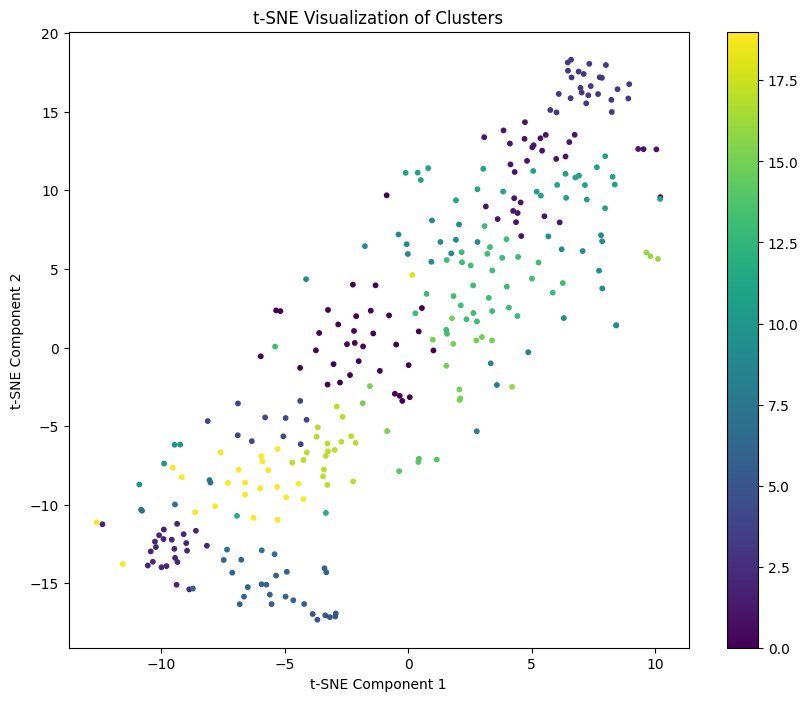

In [ ]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

#t-SNE to reduce dimensionality to 2D
tsne = TSNE(n_components=2, random_state=42)
tsne_features = tsne.fit_transform(features)

#Plot the clusters in 2D space
plt.figure(figsize=(10, 8))
scatter = plt.scatter(tsne_features[:, 0], tsne_features[:, 1], c=cluster_labels, cmap='viridis', s=10)
plt.colorbar(scatter)
plt.title('t-SNE Visualization of Clusters')
plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.show()

In [ ]:
example_index = indices_in_cluster[3]
print(f"Original filename: {test_audio_files[example_index]}")


Original filename: /content/drive/MyDrive/Thesis/ESC-50-master/audio/test/2-65484-A-18.wav


In [ ]:
import librosa
import IPython.display as ipd

#Load the audio file
audio_file = test_audio_files[example_index]
audio_data, sr = librosa.load(audio_file, sr=None)

#Play the audio
ipd.display(ipd.Audio(data=audio_data, rate=sr))

In [ ]:
#Select a cluster index to explore (e.g., cluster 0)
cluster_to_explore = 3

#Get the indices of the files in this cluster
indices_in_cluster = [i for i, label in enumerate(cluster_labels) if label == cluster_to_explore]

#Loop through the first few files in this cluster to listen to them
for idx in indices_in_cluster[:30]:  # Adjust the range to listen to more files
    audio_file = test_audio_files[idx]  # Or train_audio_files[idx] if you're analyzing training data
    audio_data, sr = librosa.load(audio_file, sr=None)

    print(f"Playing file: {audio_file}")
    ipd.display(ipd.Audio(data=audio_data, rate=sr))

Playing file: /content/drive/MyDrive/Thesis/ESC-50-master/audio/test/4-166661-A-10.wav


Playing file: /content/drive/MyDrive/Thesis/ESC-50-master/audio/test/5-219379-A-11.wav


Playing file: /content/drive/MyDrive/Thesis/ESC-50-master/audio/test/1-17092-A-27.wav


Playing file: /content/drive/MyDrive/Thesis/ESC-50-master/audio/test/2-65484-A-18.wav


Playing file: /content/drive/MyDrive/Thesis/ESC-50-master/audio/test/4-189832-B-22.wav


Playing file: /content/drive/MyDrive/Thesis/ESC-50-master/audio/test/5-212054-A-36.wav


Playing file: /content/drive/MyDrive/Thesis/ESC-50-master/audio/test/1-65483-A-13.wav


Playing file: /content/drive/MyDrive/Thesis/ESC-50-master/audio/test/4-194979-A-25.wav


Playing file: /content/drive/MyDrive/Thesis/ESC-50-master/audio/test/4-167063-A-11.wav


Playing file: /content/drive/MyDrive/Thesis/ESC-50-master/audio/test/3-103401-C-33.wav


Playing file: /content/drive/MyDrive/Thesis/ESC-50-master/audio/test/3-164630-A-11.wav


Playing file: /content/drive/MyDrive/Thesis/ESC-50-master/audio/test/3-155577-A-14.wav


Playing file: /content/drive/MyDrive/Thesis/ESC-50-master/audio/test/1-61252-A-11.wav


Playing file: /content/drive/MyDrive/Thesis/ESC-50-master/audio/test/4-107117-A-33.wav


Playing file: /content/drive/MyDrive/Thesis/ESC-50-master/audio/test/5-208810-A-11.wav


Playing file: /content/drive/MyDrive/Thesis/ESC-50-master/audio/test/5-203739-A-10.wav


Playing file: /content/drive/MyDrive/Thesis/ESC-50-master/audio/test/3-68630-B-40.wav


Playing file: /content/drive/MyDrive/Thesis/ESC-50-master/audio/test/4-165823-B-41.wav


Playing file: /content/drive/MyDrive/Thesis/ESC-50-master/audio/test/1-23996-A-35.wav


Playing file: /content/drive/MyDrive/Thesis/ESC-50-master/audio/test/4-172736-A-36.wav


Playing file: /content/drive/MyDrive/Thesis/ESC-50-master/audio/test/2-117617-A-48.wav


Playing file: /content/drive/MyDrive/Thesis/ESC-50-master/audio/test/2-73027-A-10.wav


Playing file: /content/drive/MyDrive/Thesis/ESC-50-master/audio/test/4-169127-B-41.wav


Playing file: /content/drive/MyDrive/Thesis/ESC-50-master/audio/test/1-26222-A-10.wav


Playing file: /content/drive/MyDrive/Thesis/ESC-50-master/audio/test/3-118972-A-41.wav


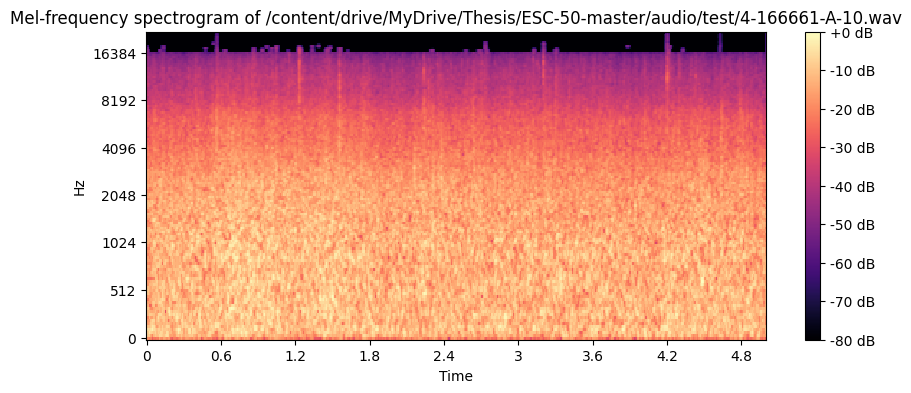

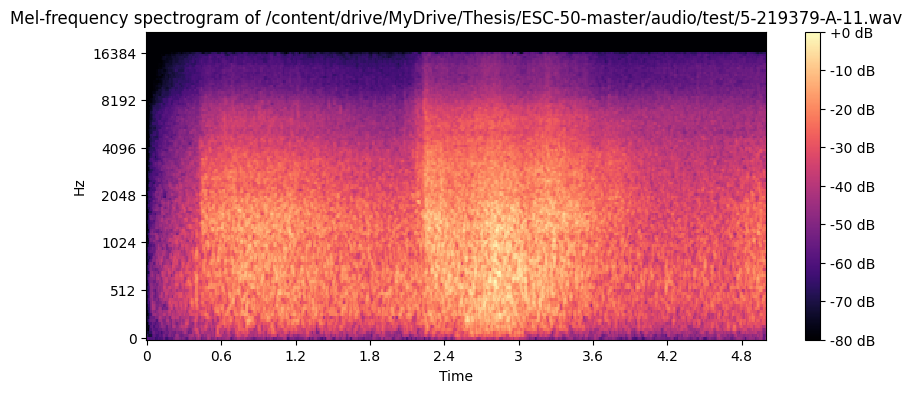

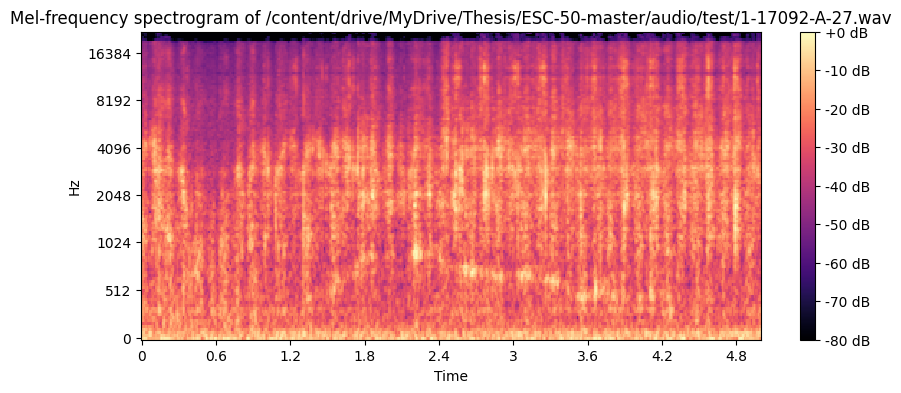

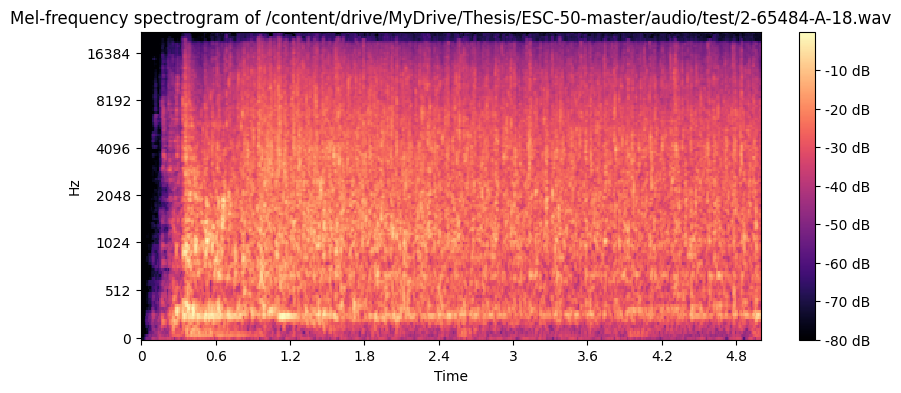

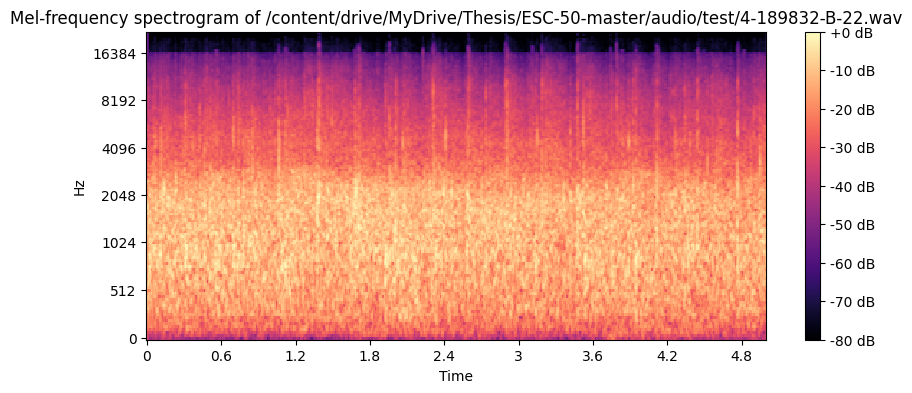

...

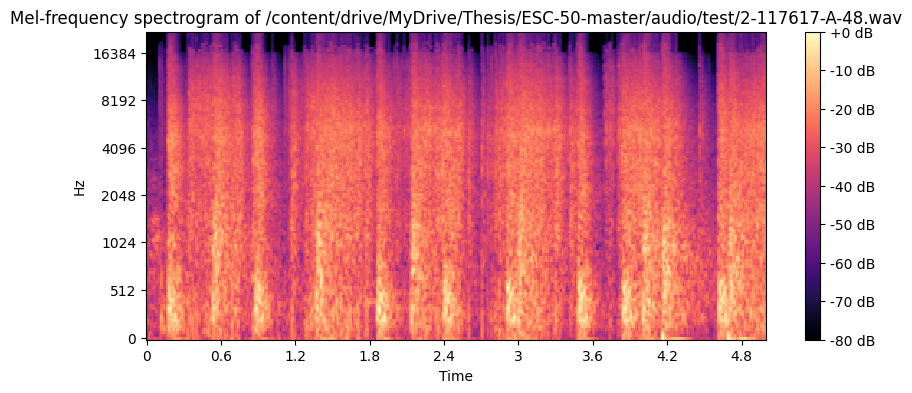

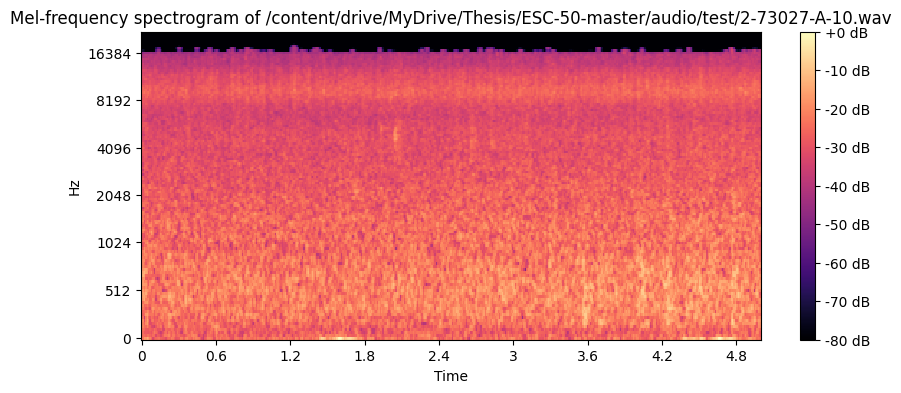

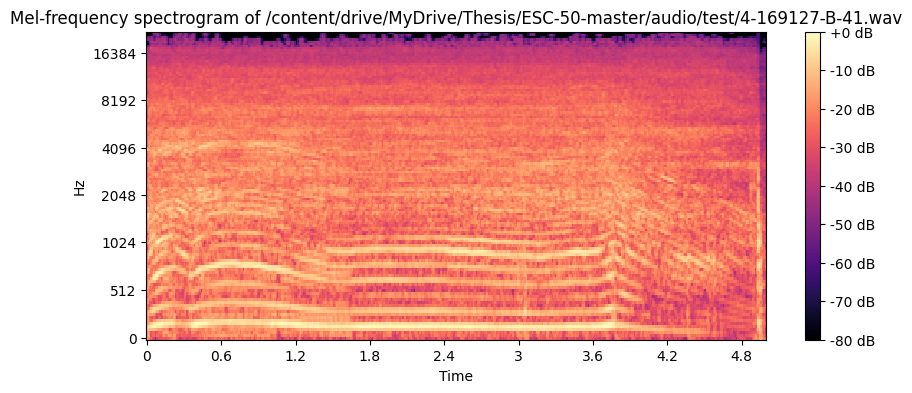

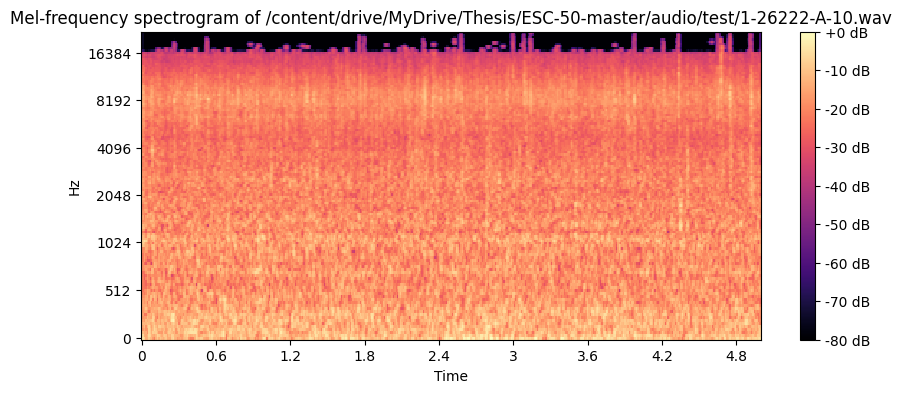

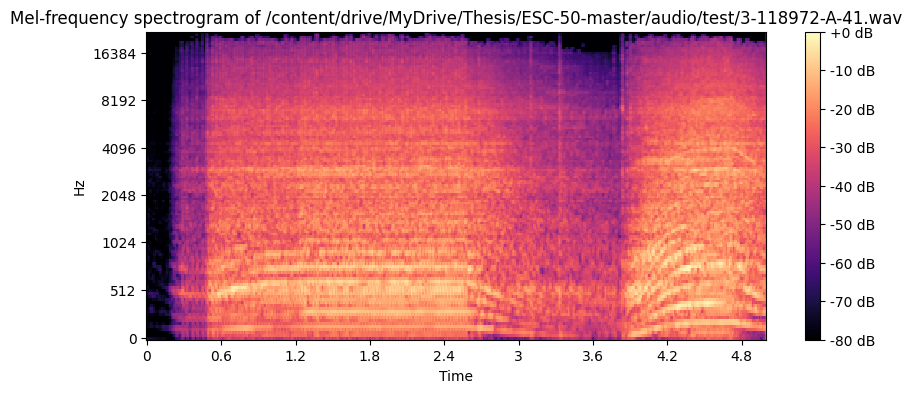

In [ ]:
import matplotlib.pyplot as plt
import librosa.display

#Visualize the first file in a cluster as a Mel-spectrogram
for idx in indices_in_cluster[:30]:  # Adjust to visualize more files
    audio_file = test_audio_files[idx]
    audio_data, sr = librosa.load(audio_file, sr=None)

    plt.figure(figsize=(10, 4))
    S = librosa.feature.melspectrogram(y=audio_data, sr=sr)
    S_dB = librosa.power_to_db(S, ref=np.max)

    librosa.display.specshow(S_dB, sr=sr, x_axis='time', y_axis='mel')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f'Mel-frequency spectrogram of {audio_file}')
    plt.show()